<a href="https://colab.research.google.com/github/sirvi2002/Competitive-Coding/blob/master/AlexNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
import numpy as np
from tensorflow import keras
import os
import cv2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
train = ImageDataGenerator(rescale=1/255)
val = ImageDataGenerator(rescale=1/255)
test = ImageDataGenerator(rescale=1/255)

In [ ]:
train_dataset = train.flow_from_directory("/content/drive/MyDrive/train",
                                          target_size=(227,227),
                                          batch_size = 32,
                                          class_mode = 'binary',
                                          )

test_dataset = test.flow_from_directory("/content/drive/MyDrive/testing",
                                          target_size=(227,227),
                                          batch_size =32,
                                          class_mode = 'binary',
                                          )

Found 372 images belonging to 2 classes.
Found 284 images belonging to 2 classes.


In [ ]:
test_dataset.labels

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1], dtype=int32)

In [ ]:

from keras import layers
from keras import models

model = models.Sequential()
model.add(layers.Conv2D(32, (11, 11), activation='relu', input_shape=(227, 227, 3)))
model.add(layers.MaxPooling2D((3, 3)))
model.add(layers.Conv2D(64, (5, 5), activation='relu'))
model.add(layers.MaxPooling2D((3, 3)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.Conv2D(256, (3, 3), activation='relu'))
model.add(layers.Conv2D(512, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((3, 3)))

model.add(layers.Flatten())
model.add(layers.Dense(200, activation='relu'))
model.add(layers.Dense(32, activation='relu'))
model.add(layers.Dense(1, activation='sigmoid'))

model.summary()

from keras import optimizers
model.compile(loss='binary_crossentropy', optimizer=optimizers.RMSprop(lr=1e-4), metrics=['accuracy'])

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 217, 217, 32)      11648     
                                                                 
 max_pooling2d (MaxPooling2D  (None, 72, 72, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 68, 68, 64)        51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 22, 22, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 20, 20, 128)       73856     
                                                                 
 conv2d_3 (Conv2D)           (None, 18, 18, 256)       2

/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/rmsprop.py:143: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [ ]:
from datetime import datetime
from keras.callbacks import ModelCheckpoint


checkpoint = ModelCheckpoint(filepath='mymodel.h5', 
                               verbose=2, save_best_only=True)

callbacks = [checkpoint]
start = datetime.now()
model_history=model.fit_generator(
  train_dataset,
  validation_data=train_dataset,
  epochs=20,
  steps_per_epoch=5,
  validation_steps=32,
    callbacks=callbacks ,verbose=2)


duration = datetime.now() - start
print("Training completed in time: ", duration)

#model.fit(train_dataset, steps_per_epoch=6, epochs=20, validation_data=train_dataset, )

<ipython-input-6-6df3fa10d31e>:10: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  model_history=model.fit_generator(


Epoch 1/20



Epoch 1: val_loss improved from inf to 0.70645, saving model to mymodel.h5
5/5 - 94s - loss: 0.6828 - accuracy: 0.5405 - val_loss: 0.7065 - val_accuracy: 0.5699 - 94s/epoch - 19s/step
Epoch 2/20


5/5 - 40s - loss: 0.7214 - accuracy: 0.5743 - 40s/epoch - 8s/step
Epoch 3/20


5/5 - 44s - loss: 0.6778 - accuracy: 0.5750 - 44s/epoch - 9s/step
Epoch 4/20


5/5 - 40s - loss: 0.6727 - accuracy: 0.5743 - 40s/epoch - 8s/step
Epoch 5/20


5/5 - 44s - loss: 0.6812 - accuracy: 0.5375 - 44s/epoch - 9s/step
Epoch 6/20


5/5 - 43s - loss: 0.6845 - accuracy: 0.5437 - 43s/epoch - 9s/step
Epoch 7/20


5/5 - 43s - loss: 0.6846 - accuracy: 0.6081 - 43s/epoch - 9s/step
Epoch 8/20


5/5 - 42s - loss: 0.6755 - accuracy: 0.5938 - 42s/epoch - 8s/step
Epoch 9/20


5/5 - 42s - loss: 0.6400 - accuracy: 0.6000 - 42s/epoch - 8s/step
Epoch 10/20


5/5 - 42s - loss: 0.6635 - accuracy: 0.5688 - 42s/epoch - 8s/step
Epoch 11/20


5/5 - 42s - loss: 0.6392 - accuracy: 0.6375 - 42s/epoch - 8s/step
Epoch 12/20


5/5 - 44s - loss: 0.6090 - accuracy: 0.6313 - 44s/epoch - 9s/step
Epoch 13/20


5/5 - 42s - loss: 0.5788 - accuracy: 0.7125 - 42s/epoch - 8s/step
Epoch 14/20


5/5 - 39s - loss: 0.5448 - accuracy: 0.7095 - 39s/epoch - 8s/step
Epoch 15/20


5/5 - 42s - loss: 0.5702 - accuracy: 0.6812 - 42s/epoch - 8s/step
Epoch 16/20


5/5 - 44s - loss: 0.5413 - accuracy: 0.6689 - 44s/epoch - 9s/step
Epoch 17/20


5/5 - 42s - loss: 0.5511 - accuracy: 0.6750 - 42s/epoch - 8s/step
Epoch 18/20


5/5 - 42s - loss: 0.5116 - accuracy: 0.7375 - 42s/epoch - 8s/step
Epoch 19/20


5/5 - 38s - loss: 0.4917 - accuracy: 0.7162 - 38s/epoch - 8s/step
Epoch 20/20


5/5 - 42s - loss: 0.4941 - accuracy: 0.7625 - 42s/epoch - 8s/step
Training completed in time:  0:23:45.055676


In [ ]:
print("Evaluate on test data")
results = model.evaluate(test_dataset, batch_size=32)
print("test loss, test acc:", results)

Evaluate on test data
9/9 [==============================] - 77s 9s/step - loss: 0.5394 - accuracy: 0.6549
test loss, test acc: [0.5393966436386108, 0.6549295783042908]


Testing noisy images


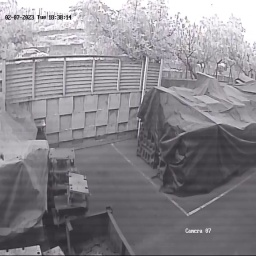

1/1 [==============================] - 0s 78ms/step


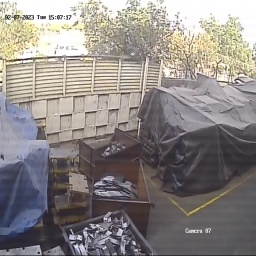

1/1 [==============================] - 0s 79ms/step


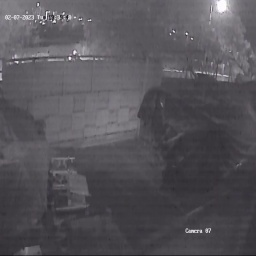

1/1 [==============================] - 0s 106ms/step


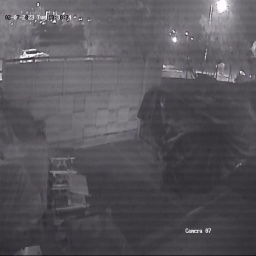

1/1 [==============================] - 0s 77ms/step


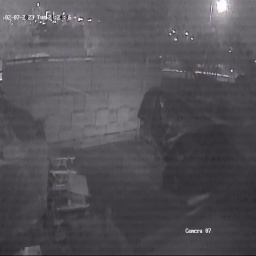

1/1 [==============================] - 0s 78ms/step


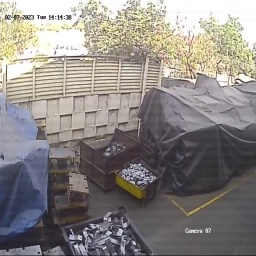

1/1 [==============================] - 0s 76ms/step


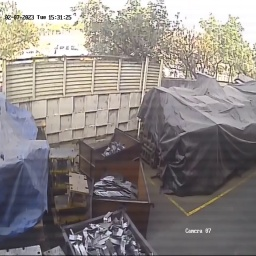

1/1 [==============================] - 0s 75ms/step


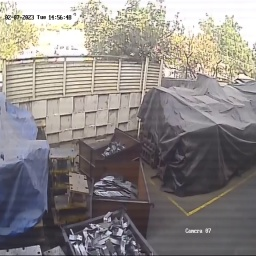

1/1 [==============================] - 0s 79ms/step


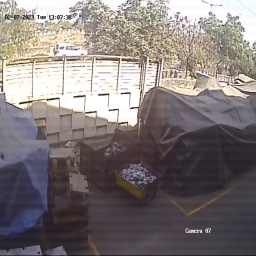

1/1 [==============================] - 0s 80ms/step


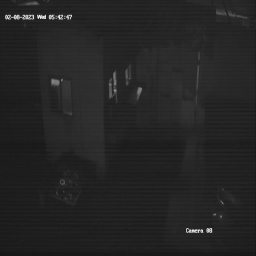

1/1 [==============================] - 0s 79ms/step


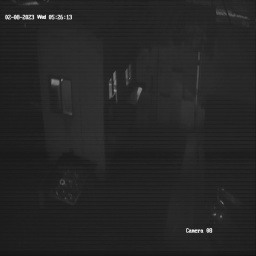

1/1 [==============================] - 0s 79ms/step


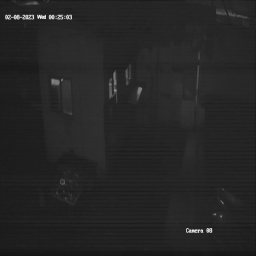

1/1 [==============================] - 0s 78ms/step


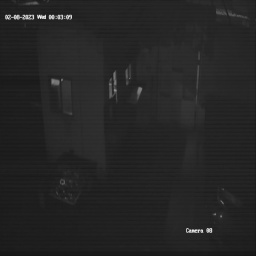

1/1 [==============================] - 0s 81ms/step


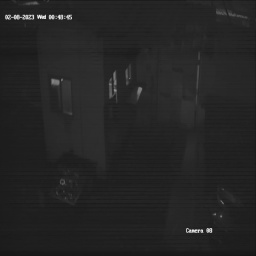

1/1 [==============================] - 0s 76ms/step


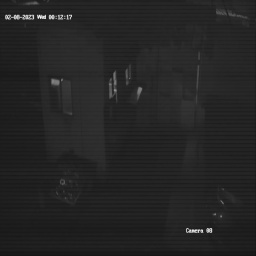

1/1 [==============================] - 0s 103ms/step


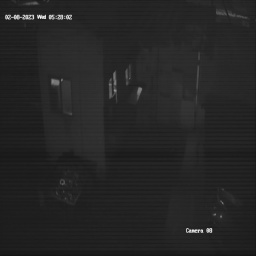

1/1 [==============================] - 0s 78ms/step


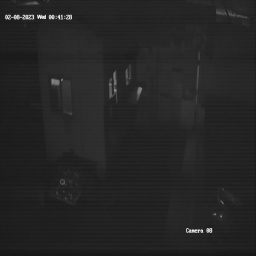

1/1 [==============================] - 0s 77ms/step


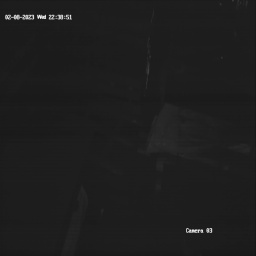

1/1 [==============================] - 0s 102ms/step


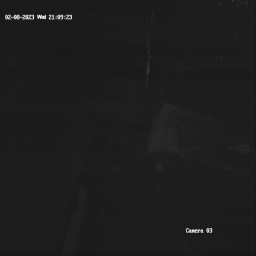

1/1 [==============================] - 0s 81ms/step


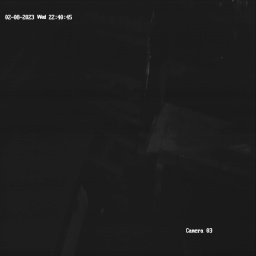

1/1 [==============================] - 0s 93ms/step


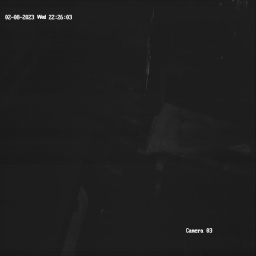

1/1 [==============================] - 0s 80ms/step


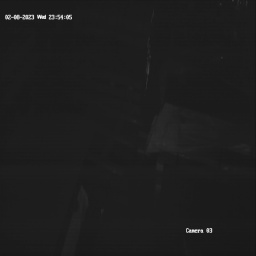

1/1 [==============================] - 0s 76ms/step


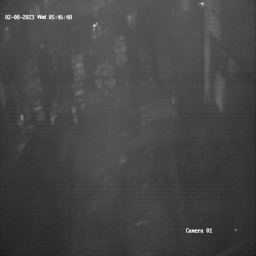

1/1 [==============================] - 0s 75ms/step


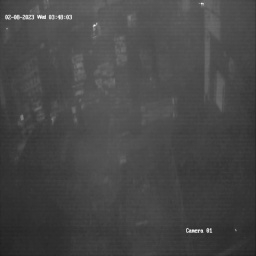

1/1 [==============================] - 0s 76ms/step


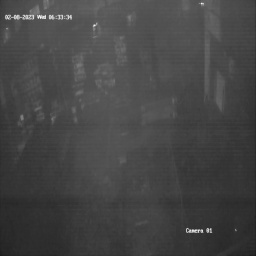

1/1 [==============================] - 0s 76ms/step


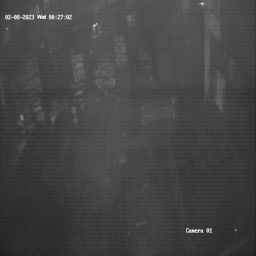

1/1 [==============================] - 0s 83ms/step


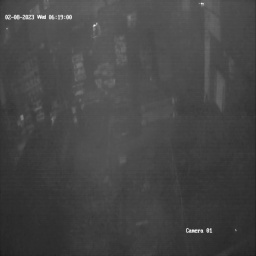

1/1 [==============================] - 0s 77ms/step


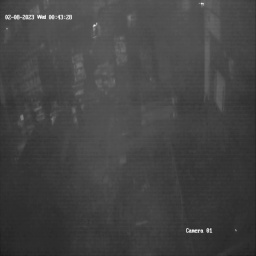

1/1 [==============================] - 0s 78ms/step


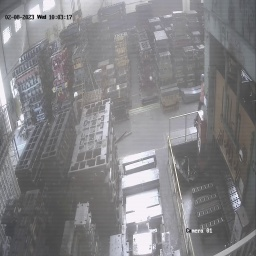

1/1 [==============================] - 0s 83ms/step


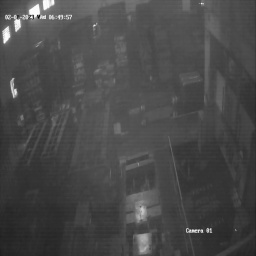

1/1 [==============================] - 0s 80ms/step


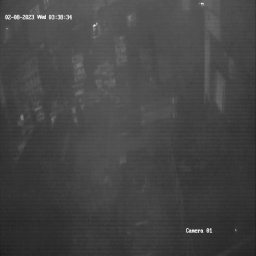

1/1 [==============================] - 0s 92ms/step


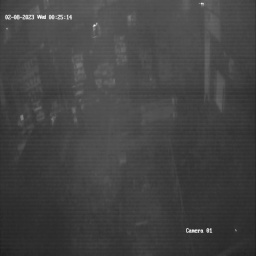

1/1 [==============================] - 0s 85ms/step


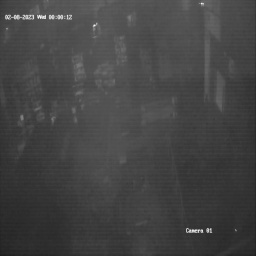

1/1 [==============================] - 0s 102ms/step


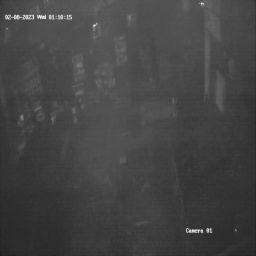

1/1 [==============================] - 0s 76ms/step


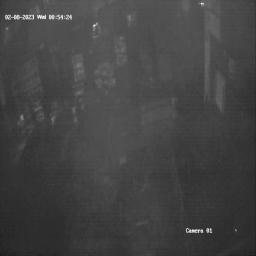

1/1 [==============================] - 0s 81ms/step


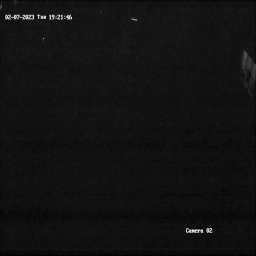

1/1 [==============================] - 0s 79ms/step


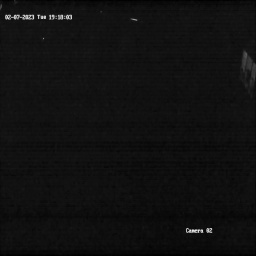

1/1 [==============================] - 0s 78ms/step


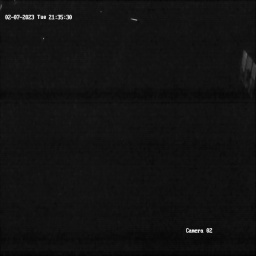

1/1 [==============================] - 0s 77ms/step


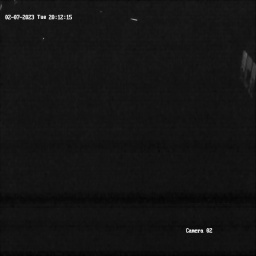

1/1 [==============================] - 0s 82ms/step


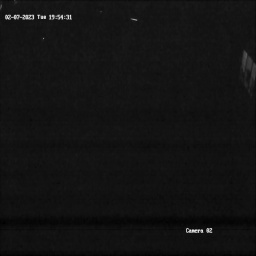

1/1 [==============================] - 0s 76ms/step


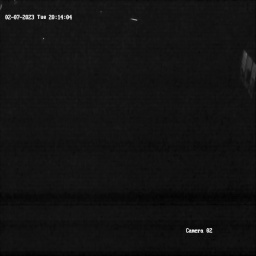

1/1 [==============================] - 0s 76ms/step


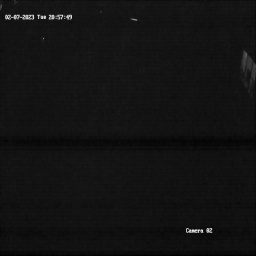

1/1 [==============================] - 0s 128ms/step


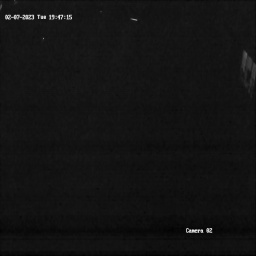

1/1 [==============================] - 0s 146ms/step


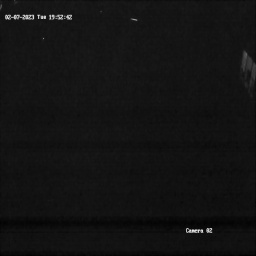

1/1 [==============================] - 0s 153ms/step


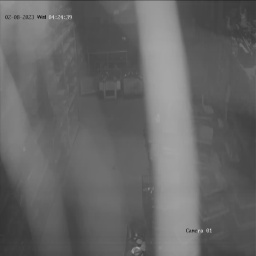

1/1 [==============================] - 0s 155ms/step


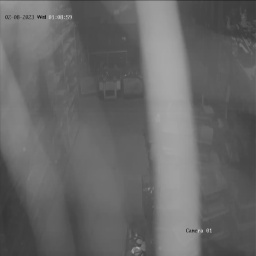

1/1 [==============================] - 0s 155ms/step


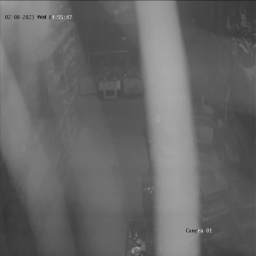

1/1 [==============================] - 0s 156ms/step


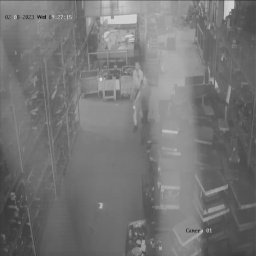

1/1 [==============================] - 0s 184ms/step


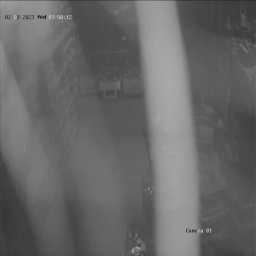

1/1 [==============================] - 0s 166ms/step


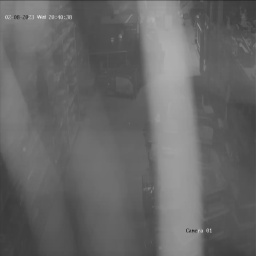

1/1 [==============================] - 0s 138ms/step


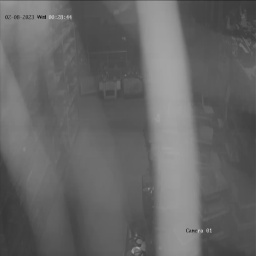

1/1 [==============================] - 0s 159ms/step


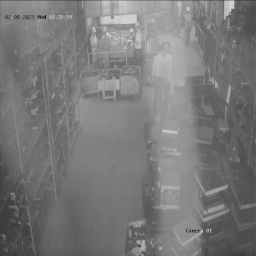

1/1 [==============================] - 0s 182ms/step


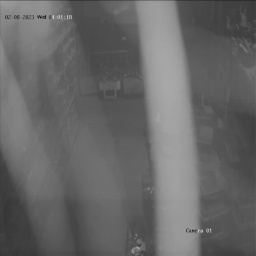

1/1 [==============================] - 0s 133ms/step


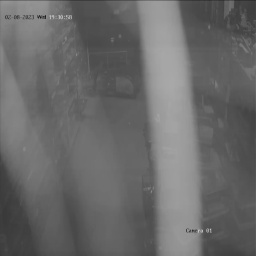

1/1 [==============================] - 0s 149ms/step


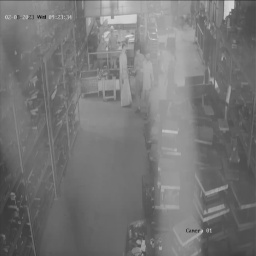

1/1 [==============================] - 0s 176ms/step


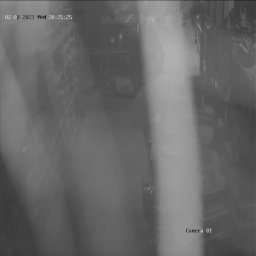

1/1 [==============================] - 0s 172ms/step


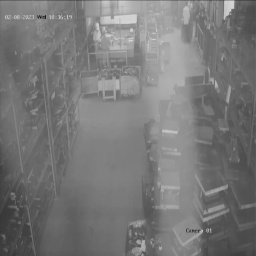

1/1 [==============================] - 0s 150ms/step


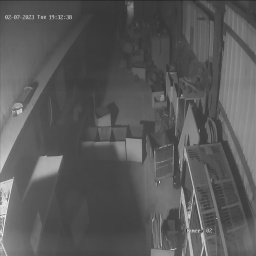

1/1 [==============================] - 0s 173ms/step


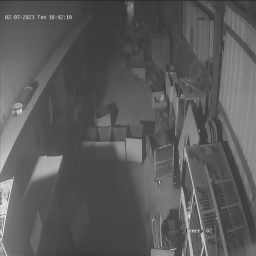

1/1 [==============================] - 0s 187ms/step


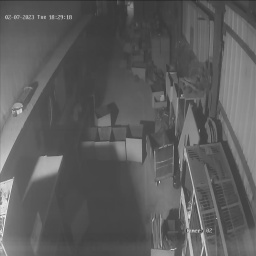

1/1 [==============================] - 0s 100ms/step


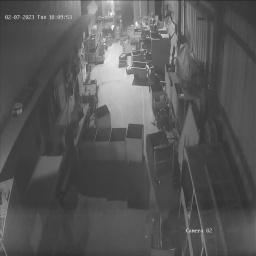

1/1 [==============================] - 0s 117ms/step


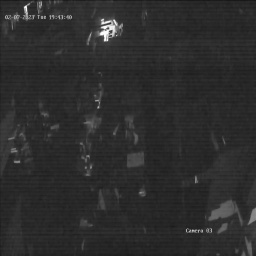

1/1 [==============================] - 0s 93ms/step


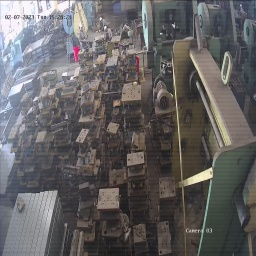

1/1 [==============================] - 0s 85ms/step


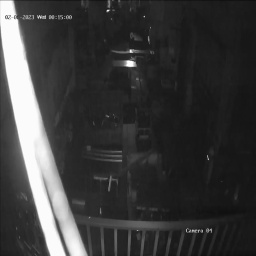

1/1 [==============================] - 0s 102ms/step


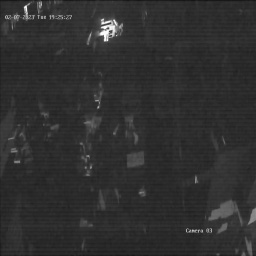

1/1 [==============================] - 0s 86ms/step


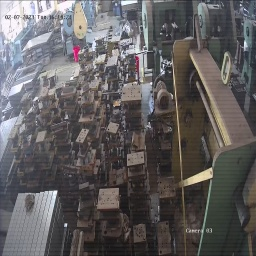

1/1 [==============================] - 0s 100ms/step


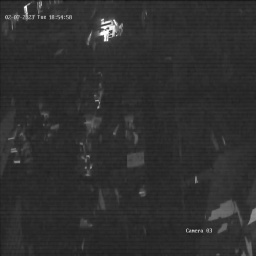

1/1 [==============================] - 0s 97ms/step


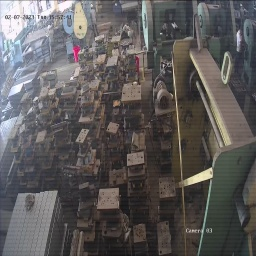

1/1 [==============================] - 0s 93ms/step


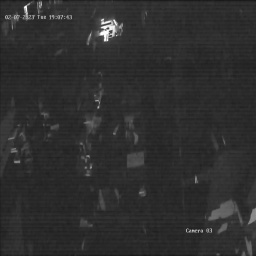

1/1 [==============================] - 0s 121ms/step


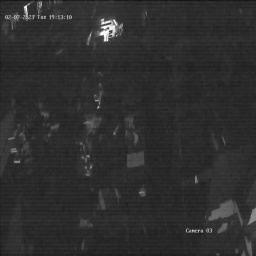

1/1 [==============================] - 0s 103ms/step


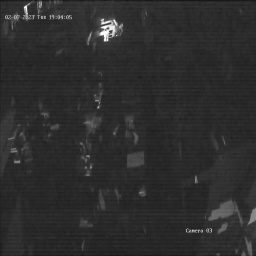

1/1 [==============================] - 0s 108ms/step


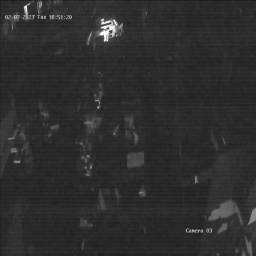

1/1 [==============================] - 0s 130ms/step


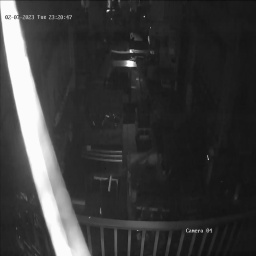

1/1 [==============================] - 0s 114ms/step


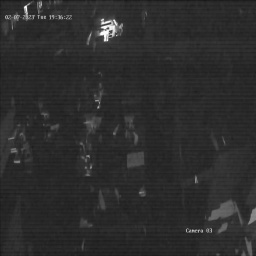

1/1 [==============================] - 0s 109ms/step


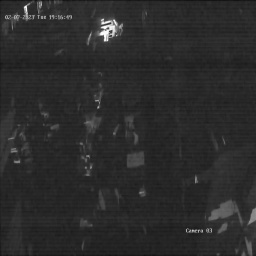

1/1 [==============================] - 0s 103ms/step


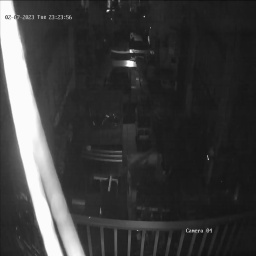

1/1 [==============================] - 0s 110ms/step


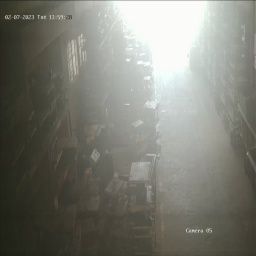

1/1 [==============================] - 0s 83ms/step


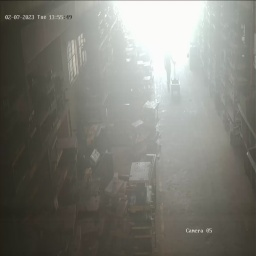

1/1 [==============================] - 0s 121ms/step


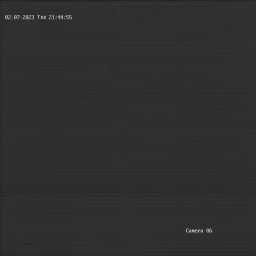

1/1 [==============================] - 0s 117ms/step


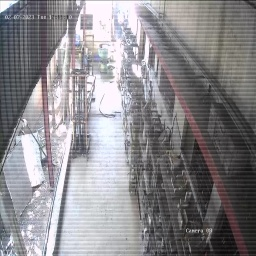

1/1 [==============================] - 0s 118ms/step


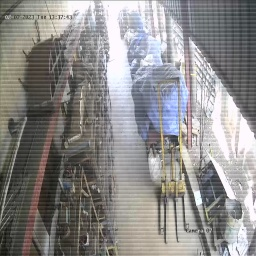

1/1 [==============================] - 0s 109ms/step


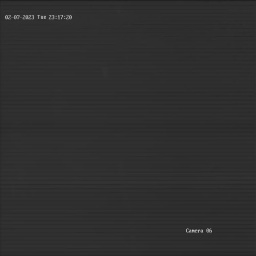

1/1 [==============================] - 0s 115ms/step


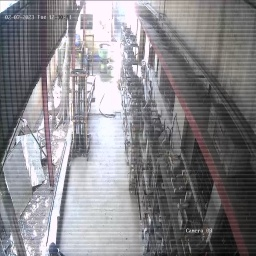

1/1 [==============================] - 0s 128ms/step


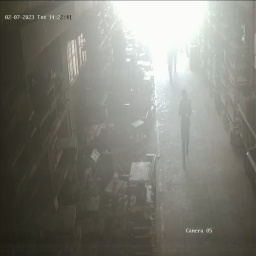

1/1 [==============================] - 0s 125ms/step


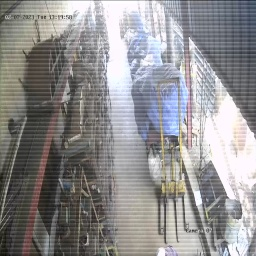

1/1 [==============================] - 0s 124ms/step


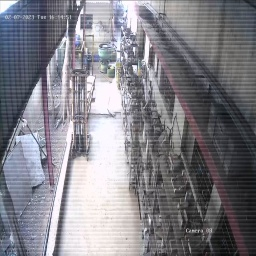

1/1 [==============================] - 0s 123ms/step


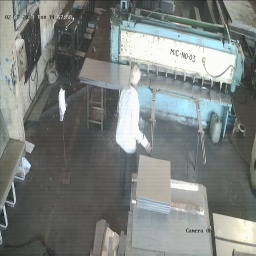

1/1 [==============================] - 0s 130ms/step


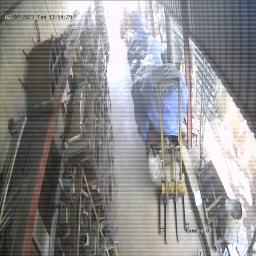

1/1 [==============================] - 0s 129ms/step


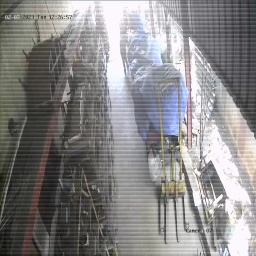

1/1 [==============================] - 0s 127ms/step


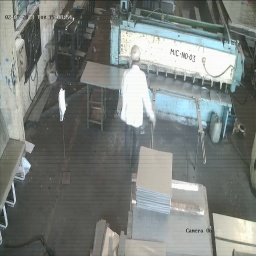

1/1 [==============================] - 0s 132ms/step


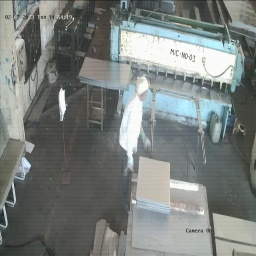

1/1 [==============================] - 0s 130ms/step


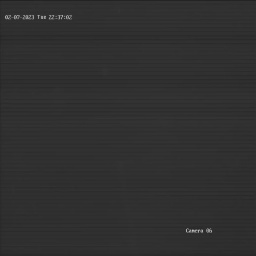

1/1 [==============================] - 0s 139ms/step


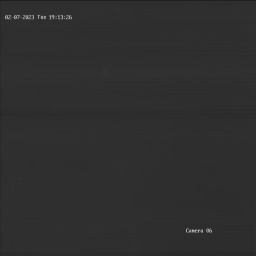

1/1 [==============================] - 0s 173ms/step


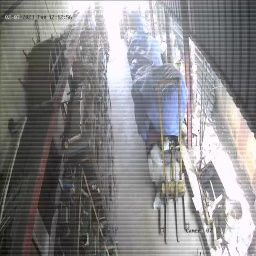

1/1 [==============================] - 0s 94ms/step


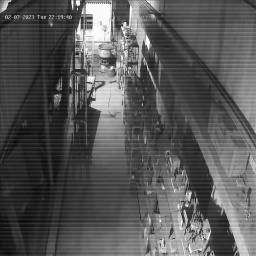

1/1 [==============================] - 0s 143ms/step


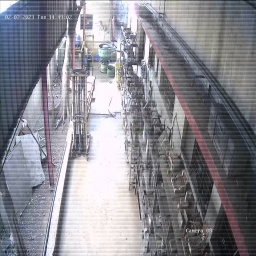

1/1 [==============================] - 0s 140ms/step


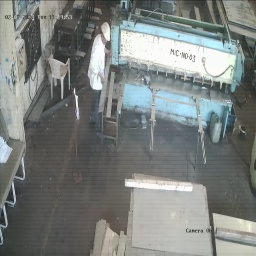

1/1 [==============================] - 0s 123ms/step


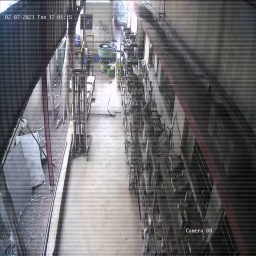

1/1 [==============================] - 0s 138ms/step


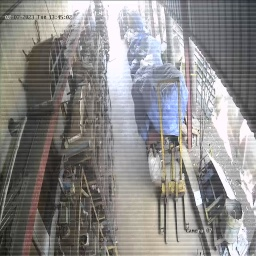

1/1 [==============================] - 0s 142ms/step


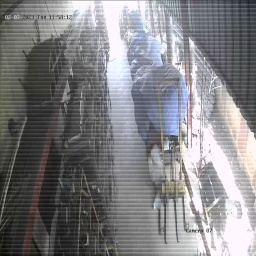

1/1 [==============================] - 0s 135ms/step


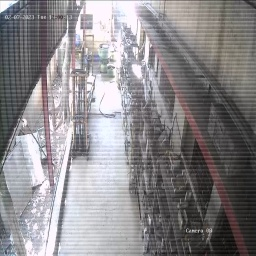

1/1 [==============================] - 0s 152ms/step


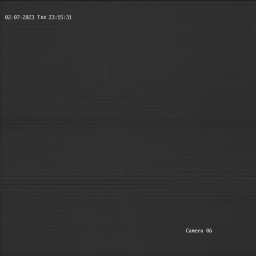

1/1 [==============================] - 0s 164ms/step


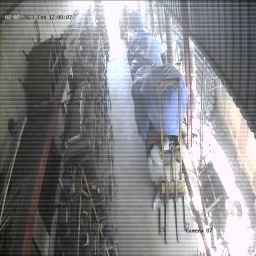

1/1 [==============================] - 0s 149ms/step


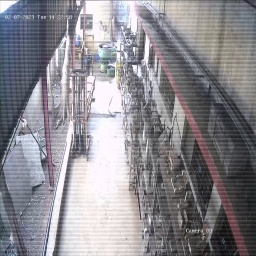

1/1 [==============================] - 0s 194ms/step


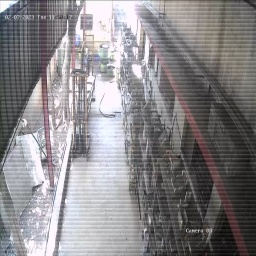

1/1 [==============================] - 0s 155ms/step


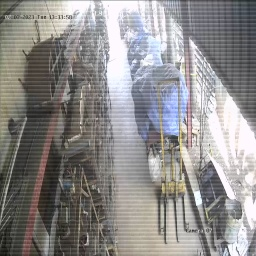

1/1 [==============================] - 0s 157ms/step


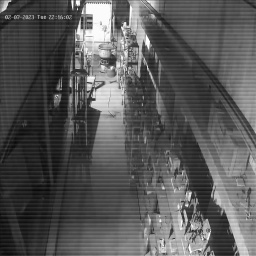

1/1 [==============================] - 0s 170ms/step


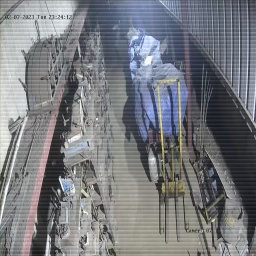

1/1 [==============================] - 0s 178ms/step


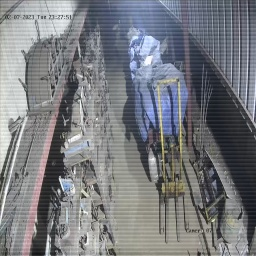

1/1 [==============================] - 0s 180ms/step


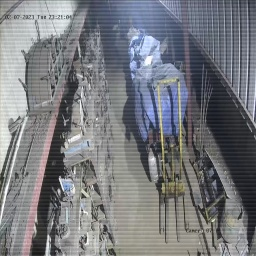

1/1 [==============================] - 0s 178ms/step


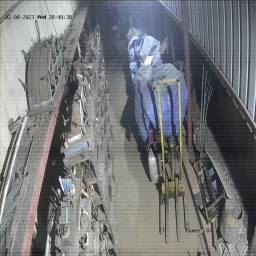

1/1 [==============================] - 0s 183ms/step


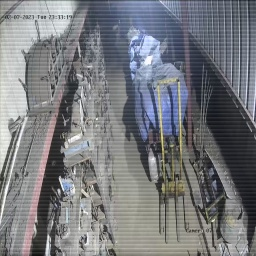

1/1 [==============================] - 0s 166ms/step


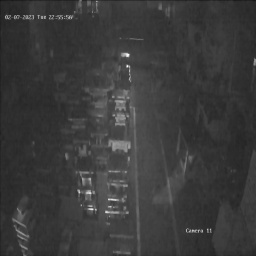

1/1 [==============================] - 0s 145ms/step


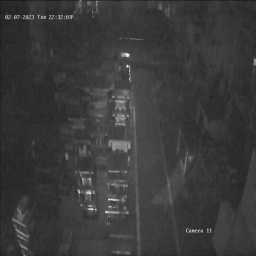

1/1 [==============================] - 0s 165ms/step


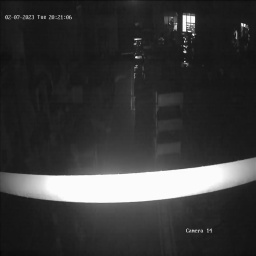

1/1 [==============================] - 0s 143ms/step


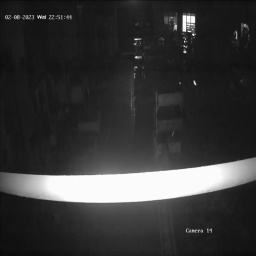

1/1 [==============================] - 0s 228ms/step


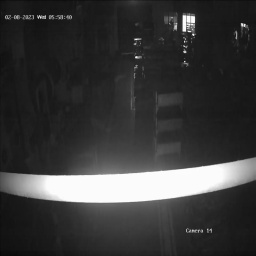

1/1 [==============================] - 0s 156ms/step


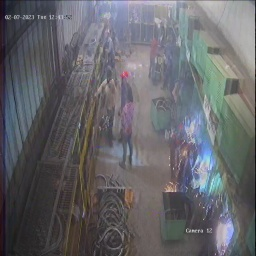

1/1 [==============================] - 0s 160ms/step


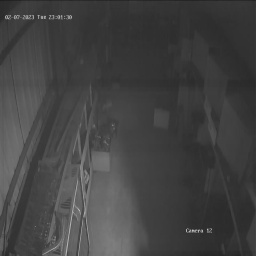

1/1 [==============================] - 0s 158ms/step


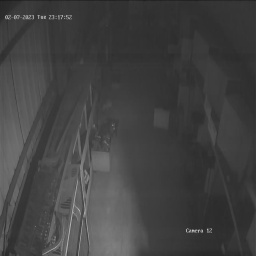

1/1 [==============================] - 0s 169ms/step


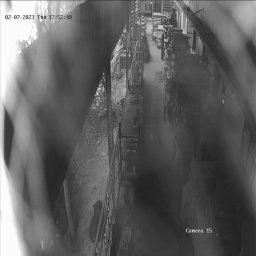

1/1 [==============================] - 0s 184ms/step


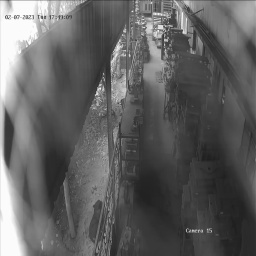

1/1 [==============================] - 0s 139ms/step


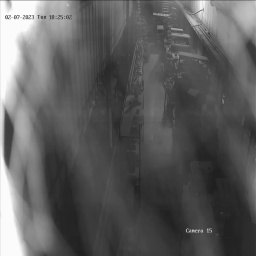

1/1 [==============================] - 0s 136ms/step


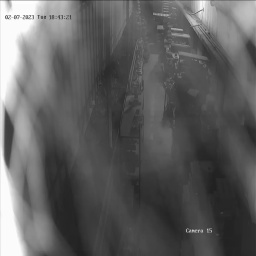

1/1 [==============================] - 0s 130ms/step


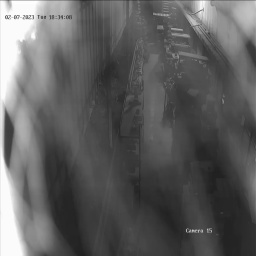

1/1 [==============================] - 0s 140ms/step


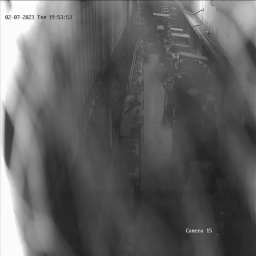

1/1 [==============================] - 0s 154ms/step


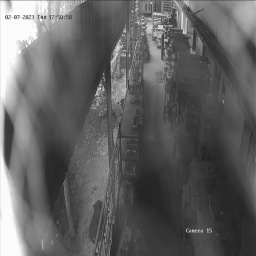

1/1 [==============================] - 0s 138ms/step


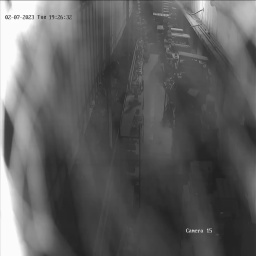

1/1 [==============================] - 0s 160ms/step


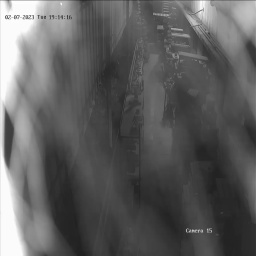

1/1 [==============================] - 0s 155ms/step


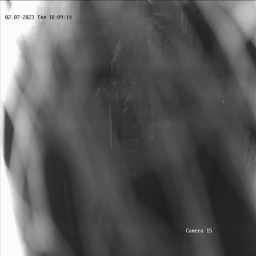

1/1 [==============================] - 0s 151ms/step


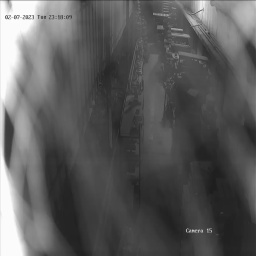

1/1 [==============================] - 0s 123ms/step
Testing clean images


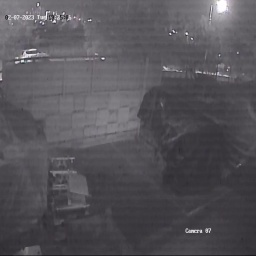

1/1 [==============================] - 0s 137ms/step


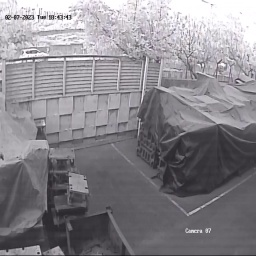

1/1 [==============================] - 0s 142ms/step


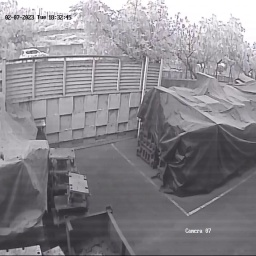

1/1 [==============================] - 0s 156ms/step


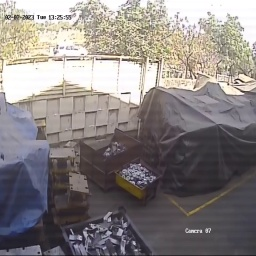

1/1 [==============================] - 0s 143ms/step


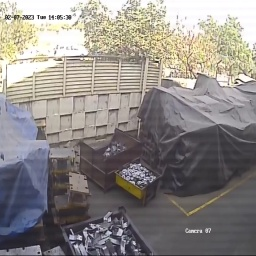

1/1 [==============================] - 0s 140ms/step


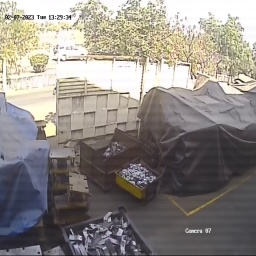

1/1 [==============================] - 0s 127ms/step


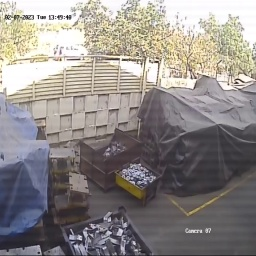

1/1 [==============================] - 0s 139ms/step


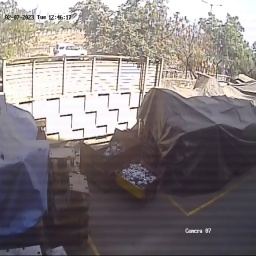

1/1 [==============================] - 0s 142ms/step


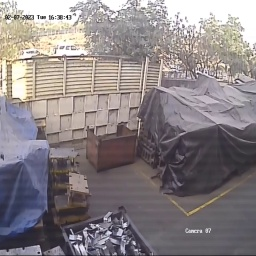

1/1 [==============================] - 0s 160ms/step


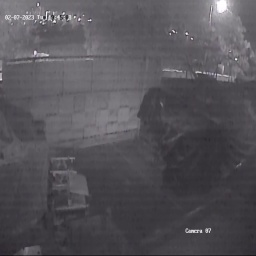

1/1 [==============================] - 0s 142ms/step


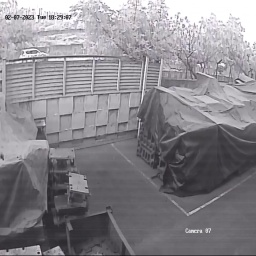

1/1 [==============================] - 0s 129ms/step


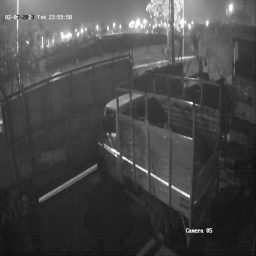

1/1 [==============================] - 0s 141ms/step


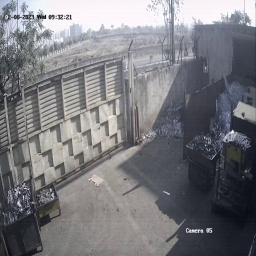

1/1 [==============================] - 0s 136ms/step


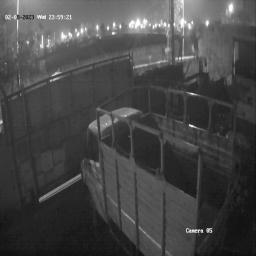

1/1 [==============================] - 0s 137ms/step


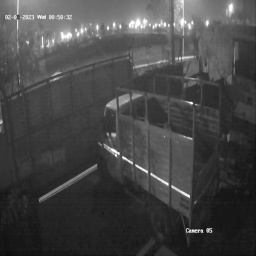

1/1 [==============================] - 0s 142ms/step


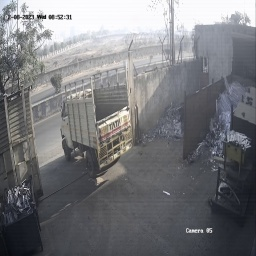

1/1 [==============================] - 0s 147ms/step


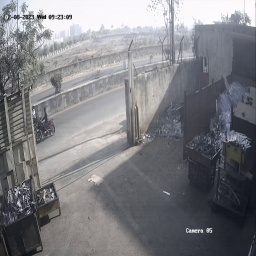

1/1 [==============================] - 0s 147ms/step


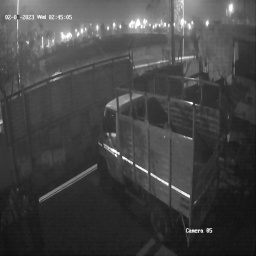

1/1 [==============================] - 0s 140ms/step


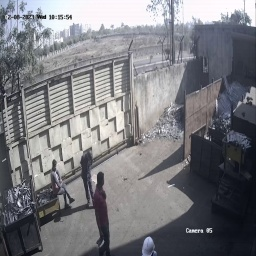

1/1 [==============================] - 0s 131ms/step


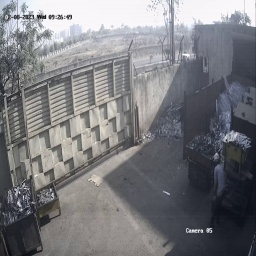

1/1 [==============================] - 0s 137ms/step


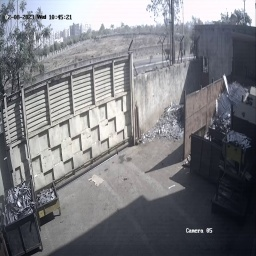

1/1 [==============================] - 0s 140ms/step


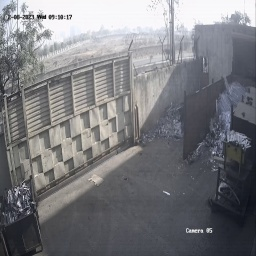

1/1 [==============================] - 0s 139ms/step


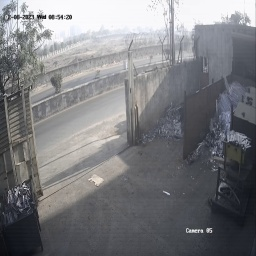

1/1 [==============================] - 0s 125ms/step


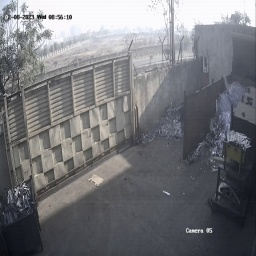

1/1 [==============================] - 0s 138ms/step


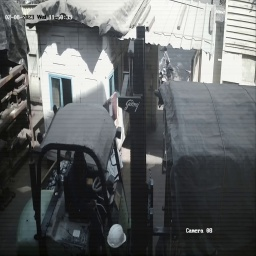

1/1 [==============================] - 0s 138ms/step


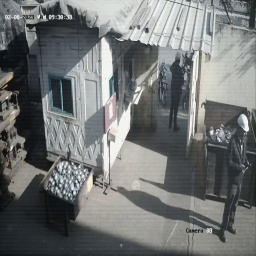

1/1 [==============================] - 0s 140ms/step


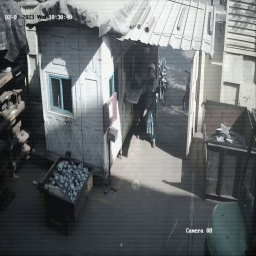

1/1 [==============================] - 0s 127ms/step


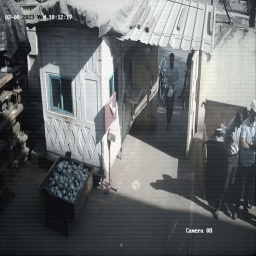

1/1 [==============================] - 0s 140ms/step


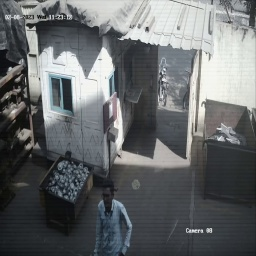

1/1 [==============================] - 0s 148ms/step


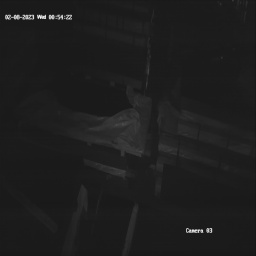

1/1 [==============================] - 0s 149ms/step


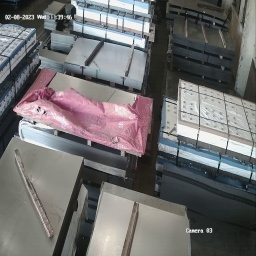

1/1 [==============================] - 0s 162ms/step


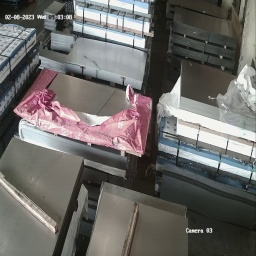

1/1 [==============================] - 0s 185ms/step


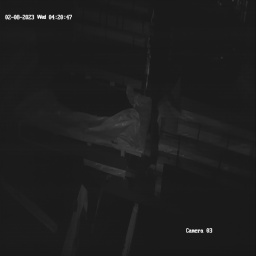

1/1 [==============================] - 0s 155ms/step


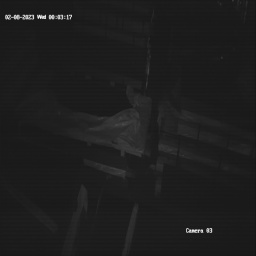

1/1 [==============================] - 0s 153ms/step


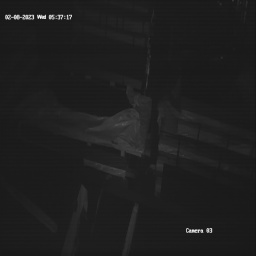

1/1 [==============================] - 0s 201ms/step


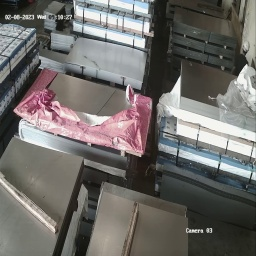

1/1 [==============================] - 0s 175ms/step


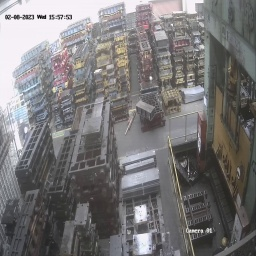

1/1 [==============================] - 0s 169ms/step


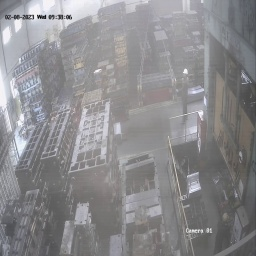

1/1 [==============================] - 0s 143ms/step


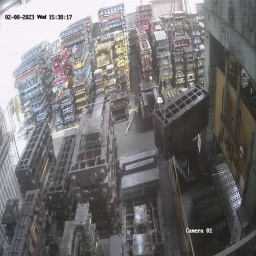

1/1 [==============================] - 0s 186ms/step


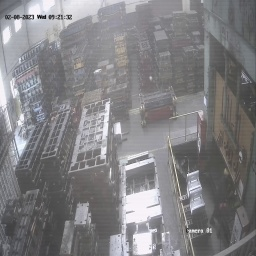

1/1 [==============================] - 0s 187ms/step


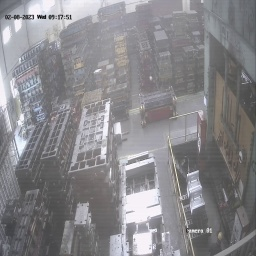

1/1 [==============================] - 0s 155ms/step


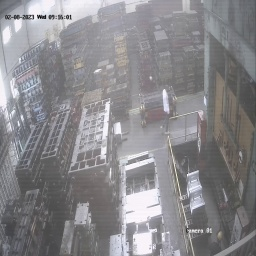

1/1 [==============================] - 0s 178ms/step


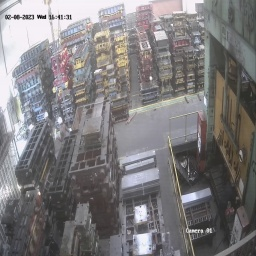

1/1 [==============================] - 0s 144ms/step


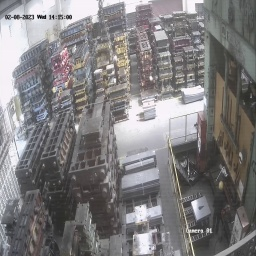

1/1 [==============================] - 0s 199ms/step


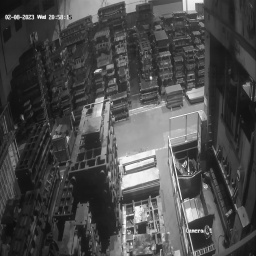

1/1 [==============================] - 0s 165ms/step


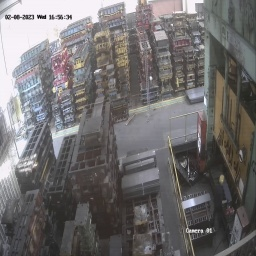

1/1 [==============================] - 0s 176ms/step


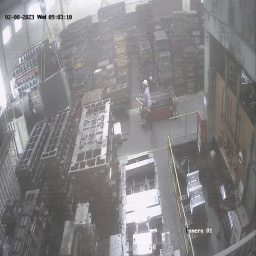

1/1 [==============================] - 0s 154ms/step


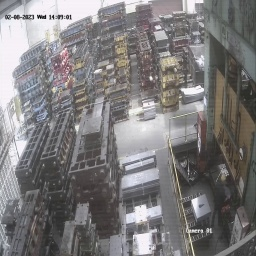

1/1 [==============================] - 0s 191ms/step


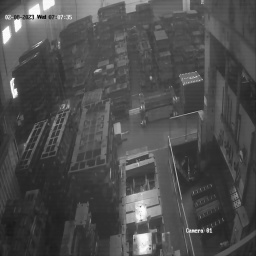

1/1 [==============================] - 0s 154ms/step


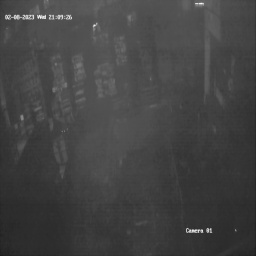

1/1 [==============================] - 0s 142ms/step


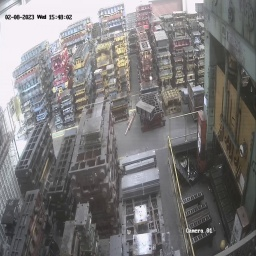

1/1 [==============================] - 0s 137ms/step


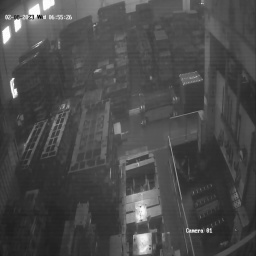

1/1 [==============================] - 0s 138ms/step


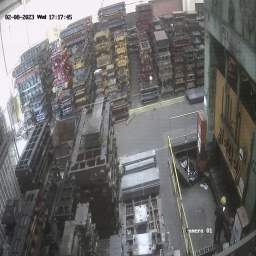

1/1 [==============================] - 0s 137ms/step


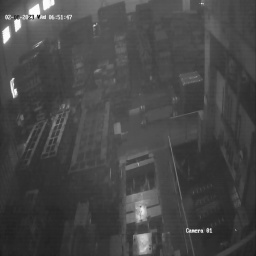

1/1 [==============================] - 0s 138ms/step


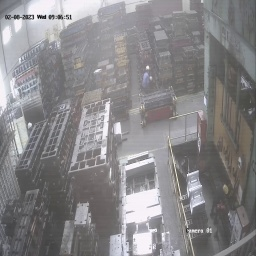

1/1 [==============================] - 0s 140ms/step


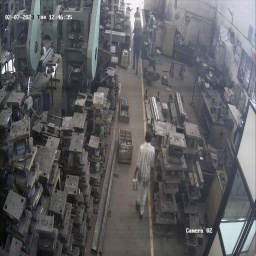

1/1 [==============================] - 0s 135ms/step


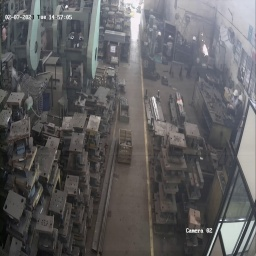

1/1 [==============================] - 0s 137ms/step


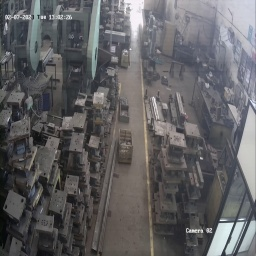

1/1 [==============================] - 0s 141ms/step


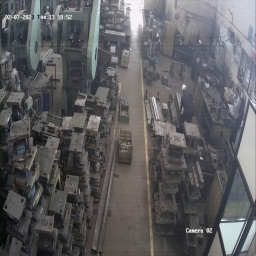

1/1 [==============================] - 0s 133ms/step


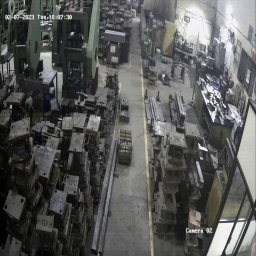

1/1 [==============================] - 0s 120ms/step


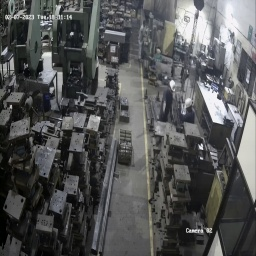

1/1 [==============================] - 0s 139ms/step


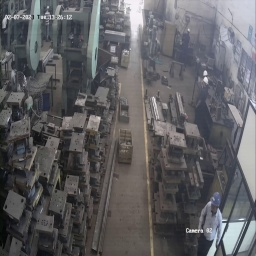

1/1 [==============================] - 0s 174ms/step


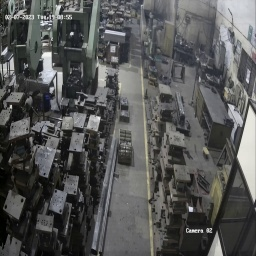

1/1 [==============================] - 0s 138ms/step


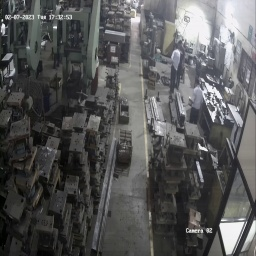

1/1 [==============================] - 0s 143ms/step


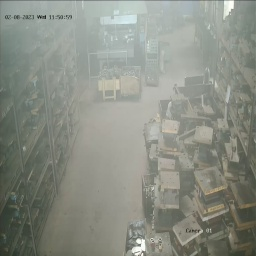

1/1 [==============================] - 0s 129ms/step


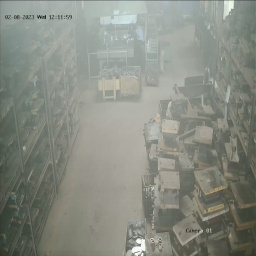

1/1 [==============================] - 0s 130ms/step


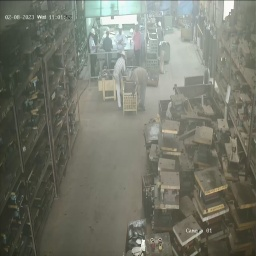

1/1 [==============================] - 0s 136ms/step


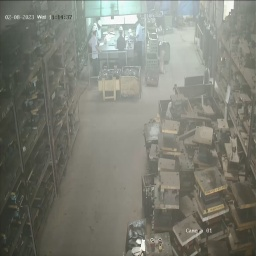

1/1 [==============================] - 0s 135ms/step


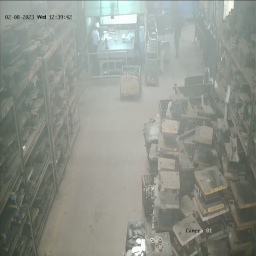

1/1 [==============================] - 0s 137ms/step


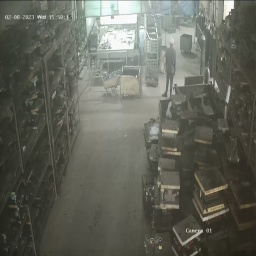

1/1 [==============================] - 0s 134ms/step


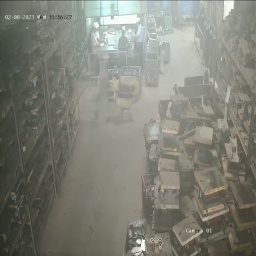

1/1 [==============================] - 0s 144ms/step


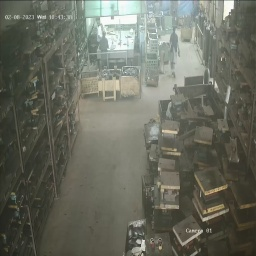

1/1 [==============================] - 0s 141ms/step


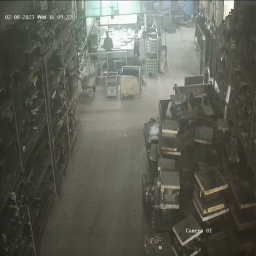

1/1 [==============================] - 0s 145ms/step


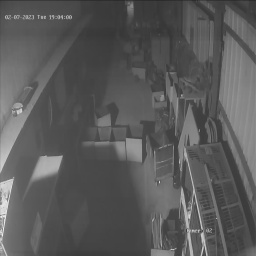

1/1 [==============================] - 0s 136ms/step


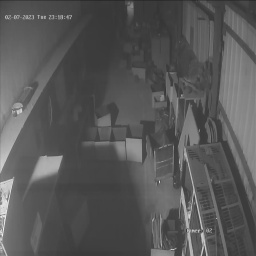

1/1 [==============================] - 0s 138ms/step


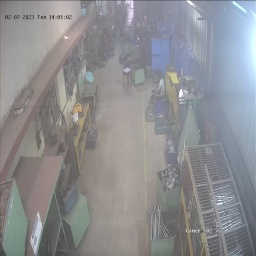

1/1 [==============================] - 0s 123ms/step


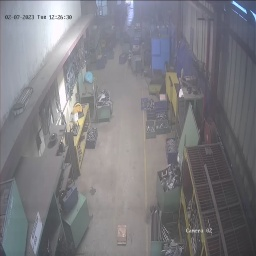

1/1 [==============================] - 0s 145ms/step


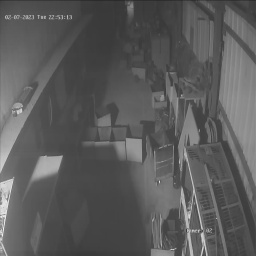

1/1 [==============================] - 0s 124ms/step


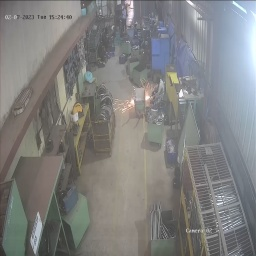

1/1 [==============================] - 0s 164ms/step


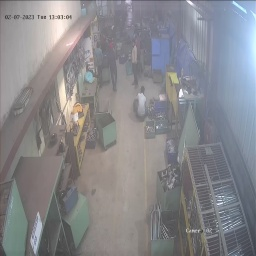

1/1 [==============================] - 0s 137ms/step


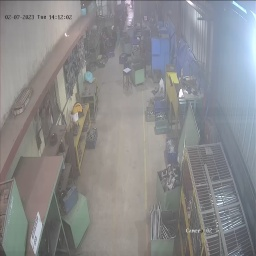

1/1 [==============================] - 0s 136ms/step


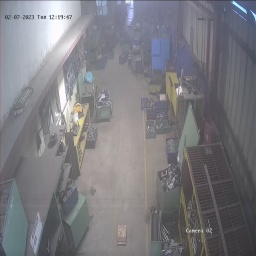

1/1 [==============================] - 0s 137ms/step


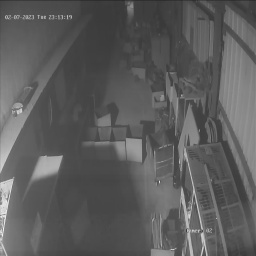

1/1 [==============================] - 0s 148ms/step


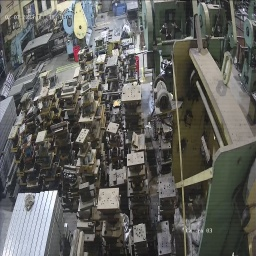

1/1 [==============================] - 0s 159ms/step


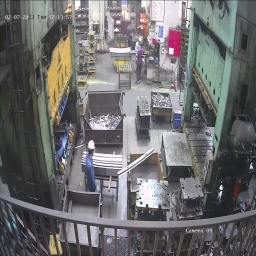

1/1 [==============================] - 0s 148ms/step


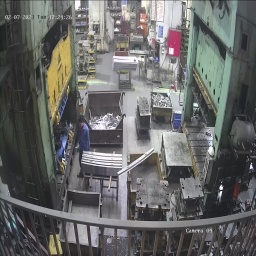

1/1 [==============================] - 0s 136ms/step


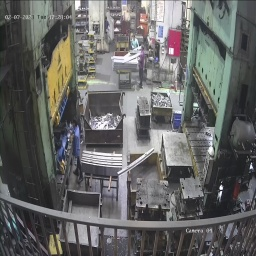

1/1 [==============================] - 0s 138ms/step


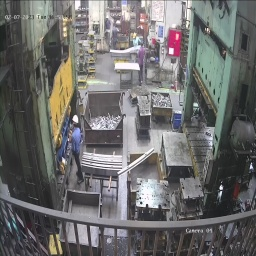

1/1 [==============================] - 0s 162ms/step


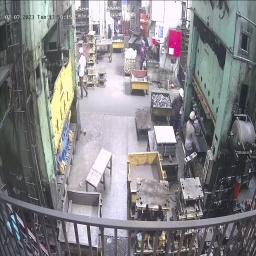

1/1 [==============================] - 0s 179ms/step


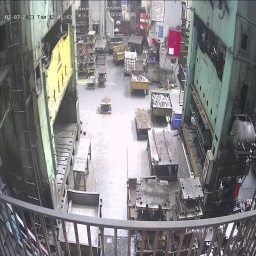

1/1 [==============================] - 0s 182ms/step


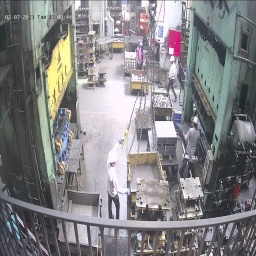

1/1 [==============================] - 0s 197ms/step


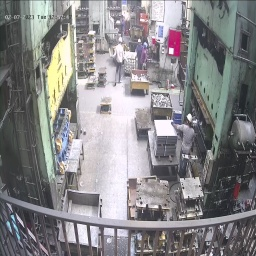

1/1 [==============================] - 0s 145ms/step


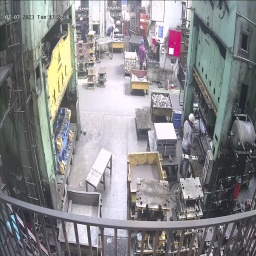

1/1 [==============================] - 0s 134ms/step


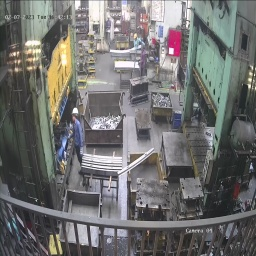

1/1 [==============================] - 0s 139ms/step


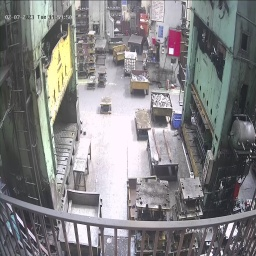

1/1 [==============================] - 0s 136ms/step


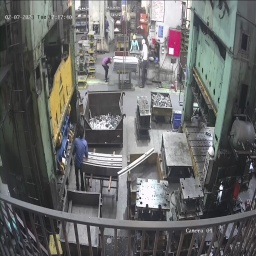

1/1 [==============================] - 0s 158ms/step


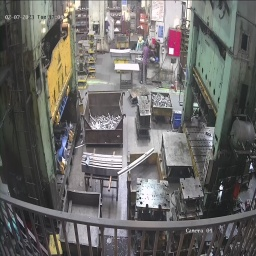

1/1 [==============================] - 0s 187ms/step


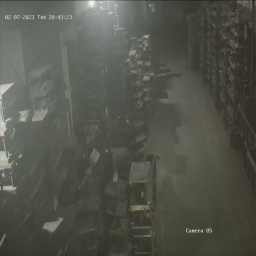

1/1 [==============================] - 0s 151ms/step


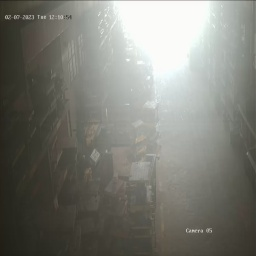

1/1 [==============================] - 0s 150ms/step


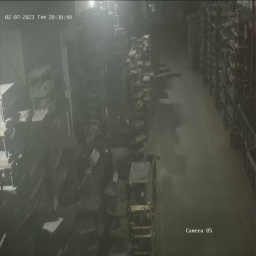

1/1 [==============================] - 0s 148ms/step


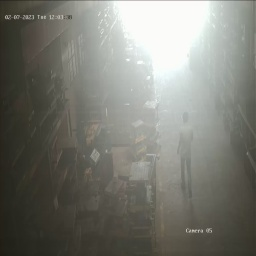

1/1 [==============================] - 0s 183ms/step


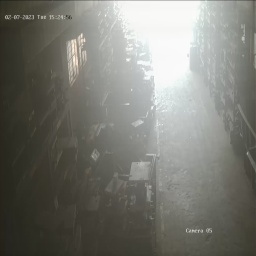

1/1 [==============================] - 0s 151ms/step


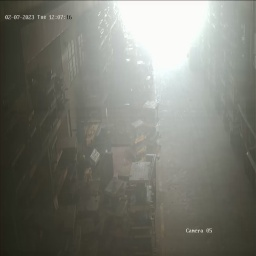

1/1 [==============================] - 0s 155ms/step


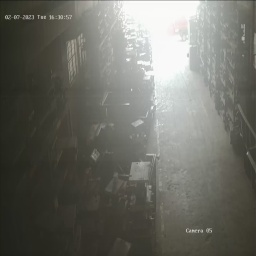

1/1 [==============================] - 0s 140ms/step


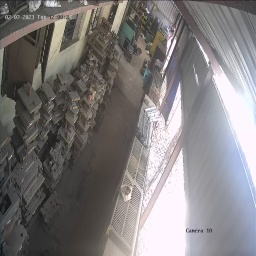

1/1 [==============================] - 0s 139ms/step


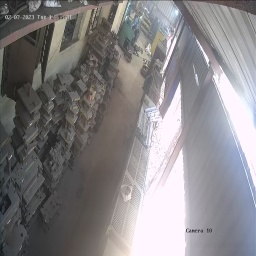

1/1 [==============================] - 0s 163ms/step


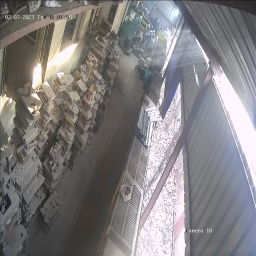

1/1 [==============================] - 0s 167ms/step


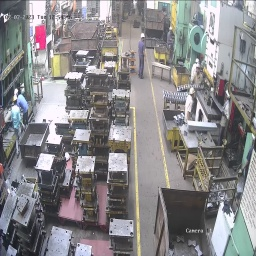

1/1 [==============================] - 0s 144ms/step


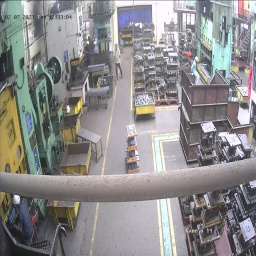

1/1 [==============================] - 0s 212ms/step


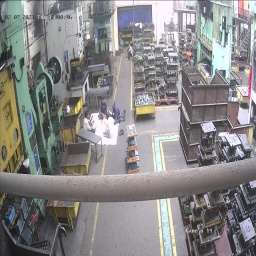

1/1 [==============================] - 0s 134ms/step


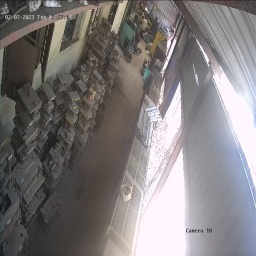

1/1 [==============================] - 0s 141ms/step


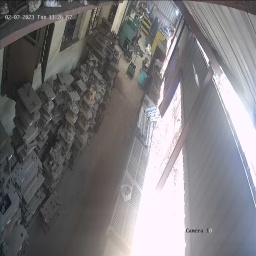

1/1 [==============================] - 0s 130ms/step


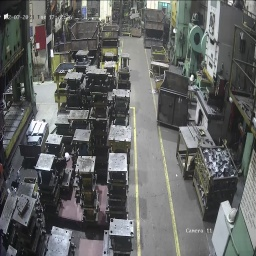

1/1 [==============================] - 0s 134ms/step


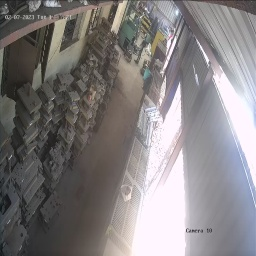

1/1 [==============================] - 0s 159ms/step


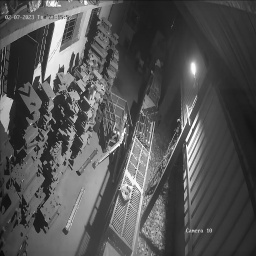

1/1 [==============================] - 0s 137ms/step


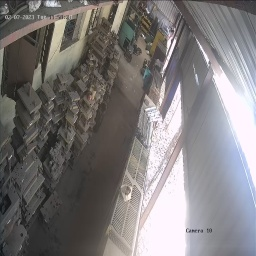

1/1 [==============================] - 0s 146ms/step


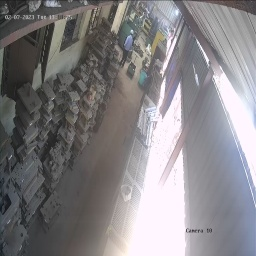

1/1 [==============================] - 0s 134ms/step


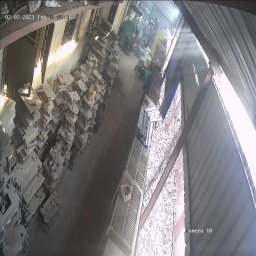

1/1 [==============================] - 0s 145ms/step


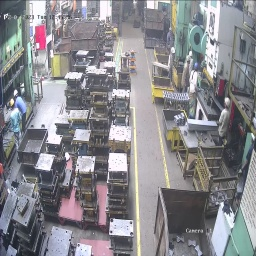

1/1 [==============================] - 0s 135ms/step


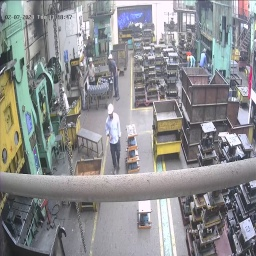

1/1 [==============================] - 0s 135ms/step


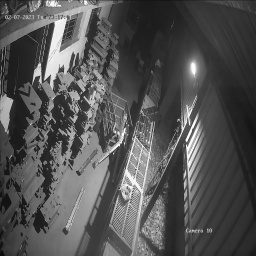

1/1 [==============================] - 0s 140ms/step


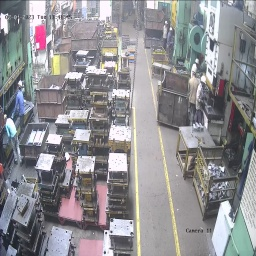

1/1 [==============================] - 0s 140ms/step


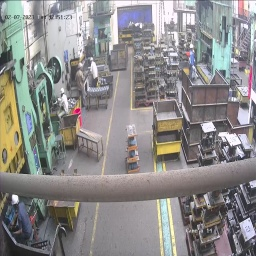

1/1 [==============================] - 0s 139ms/step


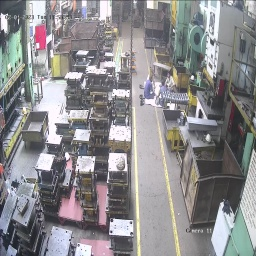

1/1 [==============================] - 0s 142ms/step


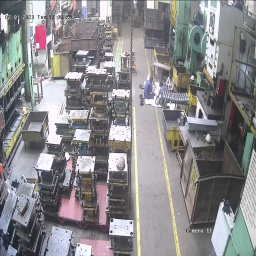

1/1 [==============================] - 0s 123ms/step


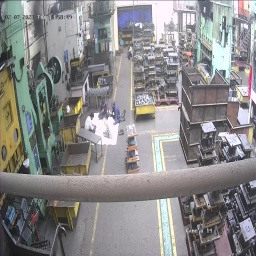

1/1 [==============================] - 0s 143ms/step


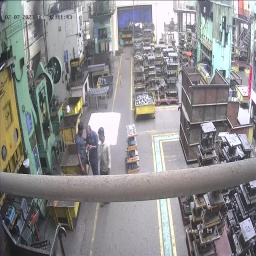

1/1 [==============================] - 0s 137ms/step


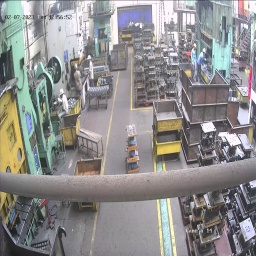

1/1 [==============================] - 0s 146ms/step


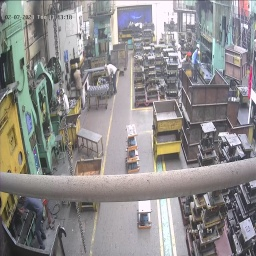

1/1 [==============================] - 0s 146ms/step


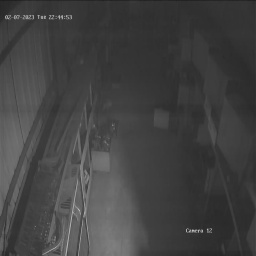

1/1 [==============================] - 0s 173ms/step


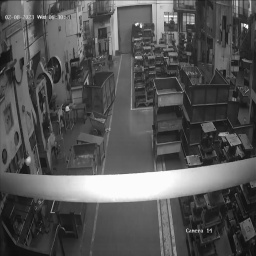

1/1 [==============================] - 0s 137ms/step


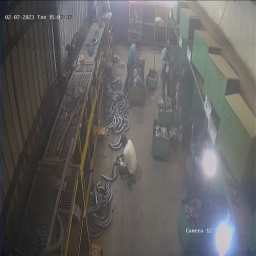

1/1 [==============================] - 0s 143ms/step


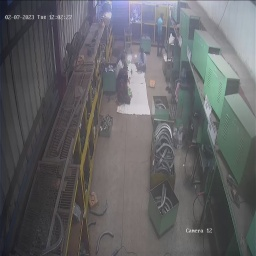

1/1 [==============================] - 0s 143ms/step


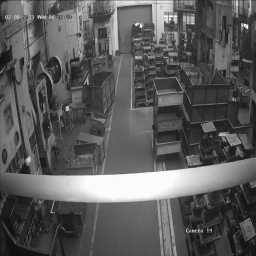

1/1 [==============================] - 0s 133ms/step


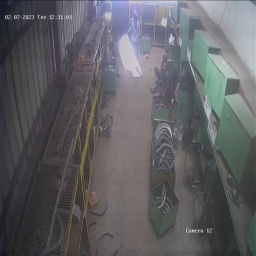

1/1 [==============================] - 0s 137ms/step


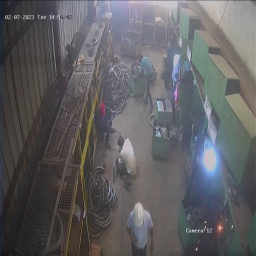

1/1 [==============================] - 0s 135ms/step


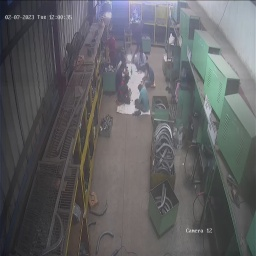

1/1 [==============================] - 0s 143ms/step


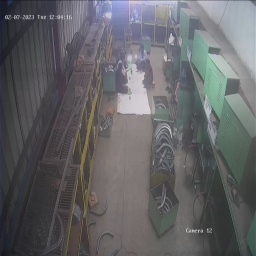

1/1 [==============================] - 0s 134ms/step


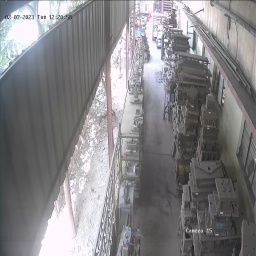

1/1 [==============================] - 0s 133ms/step


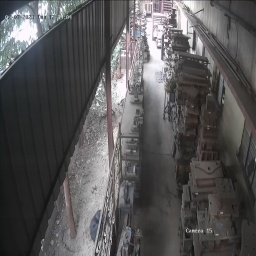

1/1 [==============================] - 0s 135ms/step


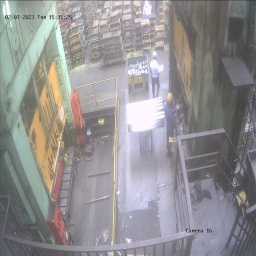

1/1 [==============================] - 0s 141ms/step


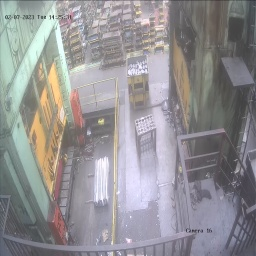

1/1 [==============================] - 0s 162ms/step


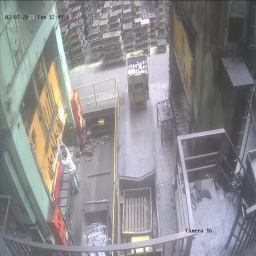

1/1 [==============================] - 0s 129ms/step


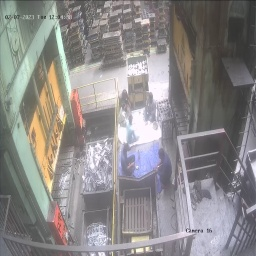

1/1 [==============================] - 0s 135ms/step


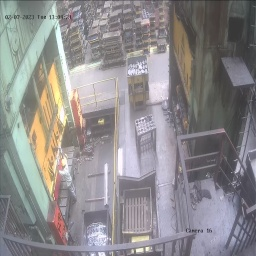

1/1 [==============================] - 0s 125ms/step


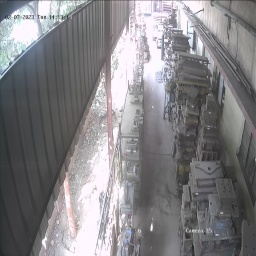

1/1 [==============================] - 0s 120ms/step


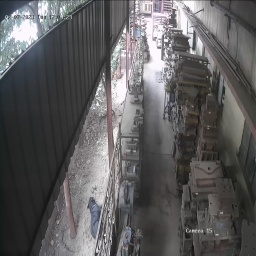

1/1 [==============================] - 0s 136ms/step


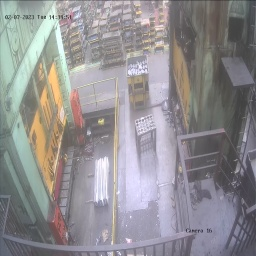

1/1 [==============================] - 0s 134ms/step


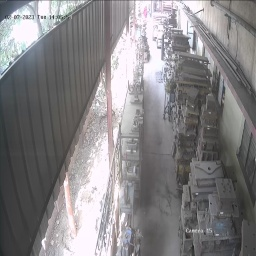

1/1 [==============================] - 0s 148ms/step


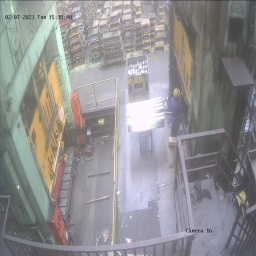

1/1 [==============================] - 0s 176ms/step


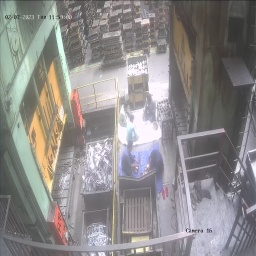

1/1 [==============================] - 0s 156ms/step


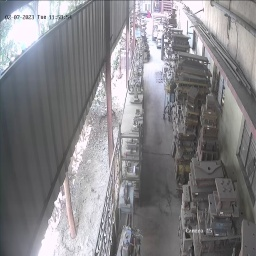

1/1 [==============================] - 0s 170ms/step


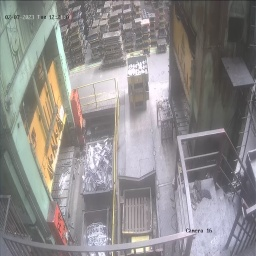

1/1 [==============================] - 0s 150ms/step
0:01:15.276890


In [ ]:
##custom prediction
pred=[]
import glob
from datetime import datetime
start = datetime.now()

print("Testing noisy images")
for img in glob.glob('/content/drive/MyDrive/testing/noise/*.jpg'):
  val=predictimg(img)
  pred.append(val)
print("Testing clean images")
for img in glob.glob('/content/drive/MyDrive/testing/clean/*.jpg'):
  val=predictimg(img)
  pred.append(val)

print(datetime.now()-start)
  

In [ ]:
from google.colab.patches import cv2_imshow

def predictimg(filename):
    img1 = image.load_img(filename,target_size=(227,227))
    
    # plt.imshow(img1)
    cv2_imshow(cv2.imread(filename))
    Y = image.img_to_array(img1)
    
    X = np.expand_dims(Y,axis=0)
    val = model.predict(X)
    if val==1:
      return 0
    else:
      return 1
    

In [ ]:
print(pred)
print(pred.count(1))
print(pred.count(0))

[1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
244
40


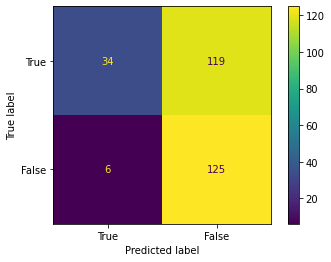

In [ ]:
from sklearn import metrics
confusion_matrix = metrics.confusion_matrix(test_dataset.labels , pred)

cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = [True, False])

cm_display.plot()
plt.show()

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score

print('Precision: %.3f' % precision_score(test_dataset.labels , pred))
print('Recall: %.3f' % recall_score(test_dataset.labels , pred))

Precision: 0.512
Recall: 0.954
